In [1]:
import torch
from torchvision import transforms, datasets
import numpy as np
from helpers import apply_score_cam, plot_image_grid
from functools import reduce
from tqdm import tqdm

Based on: https://arxiv.org/abs/1910.01279

# Set paths and variables

In [2]:
DATA_PATH = './15SceneData/'
MODELS_PATH = './models/'
PLOTS_PATH = './plots/'
MODEL_NAMES = [
    'efficientnetb0_v2', 
    'efficientnetb0_pretrianed_fe_freeze',
    'rotation_supervised',
    'perturbation_supervised'
]


DEVICE = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

# Load data

In [3]:
# Load the datasets with ImageFolder
val_dataset = datasets.ImageFolder(DATA_PATH + 'validation',
                                   transform=transforms.Compose([
                                       transforms.Resize((224, 224)),
                                       transforms.ToTensor(),
                                       transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                                              std=[0.229, 0.224, 0.225])
                                   ]))

# Image normalizer for reversing normalization to apply heatmap
inv_normalize = transforms.Normalize(
   mean= [-m/s for m, s in zip([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])],
   std= [1/s for s in [0.229, 0.224, 0.225]]
)

In [4]:
# Get the correct labels for each model
correct_labels = {name:[] for name in MODEL_NAMES}
for model_name in MODEL_NAMES:
    print(model_name)
    model = torch.load(MODELS_PATH + model_name + '.pt', map_location=DEVICE)
    model.eval()
    model.to(DEVICE)
    for i, (image, label) in enumerate(val_dataset):
        output = model(image.to(DEVICE).unsqueeze(0))
        pred = output.argmax(dim=1, keepdim=True)
        if pred == label:
            correct_labels[model_name].append(i)

efficientnetb0_v2
efficientnetb0_pretrianed_fe_freeze
rotation_supervised
perturbation_supervised


In [5]:
# Get the intersection of correct labels -- to chose images that are correctly classified by all modelss
intersection = reduce(np.intersect1d, [correct_labels[model_name] for model_name in MODEL_NAMES])

In [6]:
# Check if there are 8 different classes in selected images
img_nums = [
    intersection[0], 
    intersection[100], 
    intersection[200], 
    intersection[300], 
    intersection[400], 
    intersection[500], 
    intersection[600], 
    intersection[700]
    ]

for num in img_nums:
    print(val_dataset[num][1])


0
1
2
3
5
8
9
10


In [7]:
# Double check if the images are correctly classified by all models
for img_num in img_nums:
    img, label = val_dataset[img_num]
    print(img_num, label)
    prediction = model(img.unsqueeze(0).to(DEVICE)).argmax().item()
    if prediction != label:
        print('img: ', img_num)
        print('Incorrectly classified as: ', prediction)

21 0
300 1
472 2
652 3
1015 5
1599 8
1828 9
2052 10


100%|██████████| 8/8 [00:27<00:00,  3.38s/it]


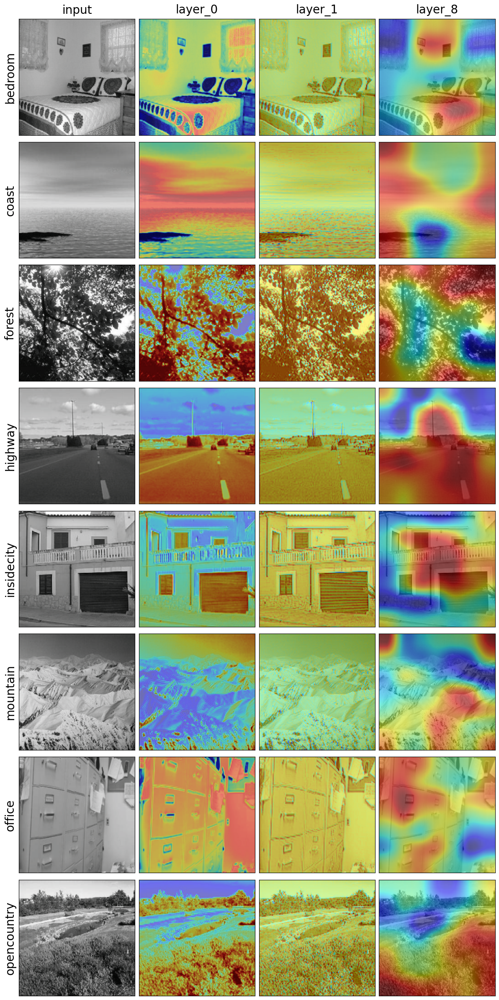

100%|██████████| 8/8 [00:24<00:00,  3.12s/it]


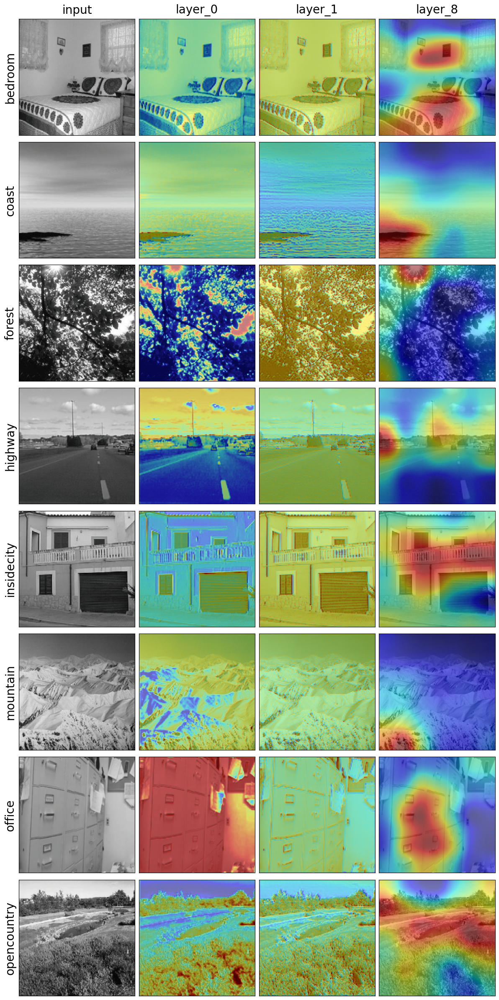

100%|██████████| 8/8 [00:25<00:00,  3.19s/it]


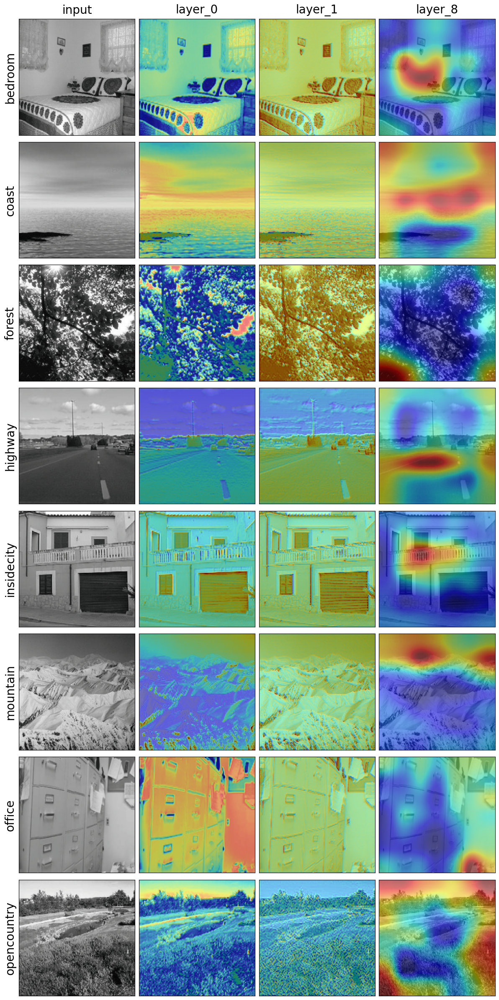

100%|██████████| 8/8 [00:26<00:00,  3.36s/it]


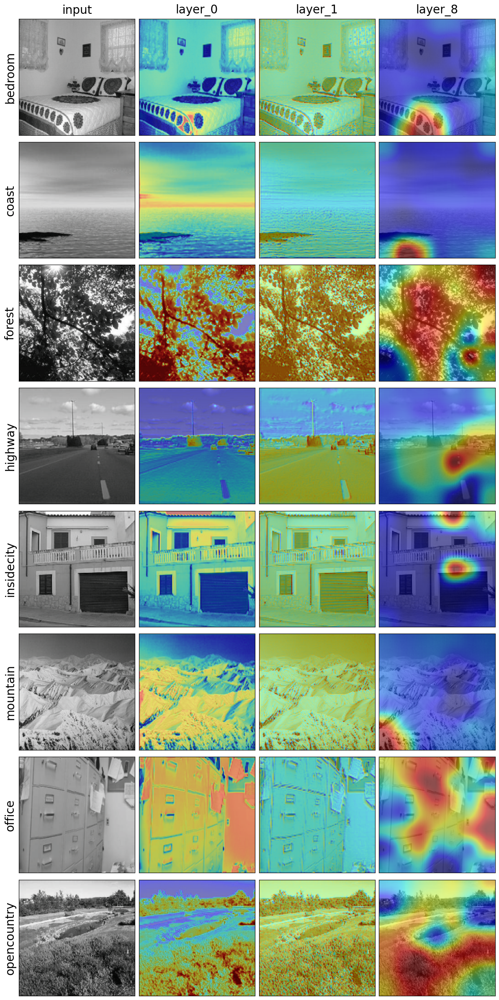

In [8]:
# Score cam calculation and plotting
for model_name in MODEL_NAMES:
    model = torch.load(MODELS_PATH + model_name +'.pt', map_location=DEVICE)

    images = []
    layers = [0, 1, 8]
    for img_num in tqdm(img_nums):
        input_img = inv_normalize(val_dataset[img_num][0])
        input_img = transforms.ToPILImage()(input_img)
        images.append(input_img)
        for layer in layers:
            score_cam_result = apply_score_cam(
                val_dataset[img_num][0], 
                model, 
                model.features[layer], 
                inv_normalize, 
                batch_size=64, 
                alpha=0.5
                )
            images.append(score_cam_result)
            

    layers = ['input'] + ['layer_' + str(i) for i in layers]

    idx_to_class = {v: k for k, v in val_dataset.class_to_idx.items()}
    row_labels = [idx_to_class[val_dataset[img_num][1]] for img_num in img_nums]

    cam_grid_plot = plot_image_grid(images, row_labels, layers)

    cam_grid_plot.savefig(PLOTS_PATH + 'score_cam/' + model_name + '_cam_grid_plot.png', bbox_inches='tight', dpi=300)


100%|██████████| 3/3 [00:23<00:00,  7.68s/it]


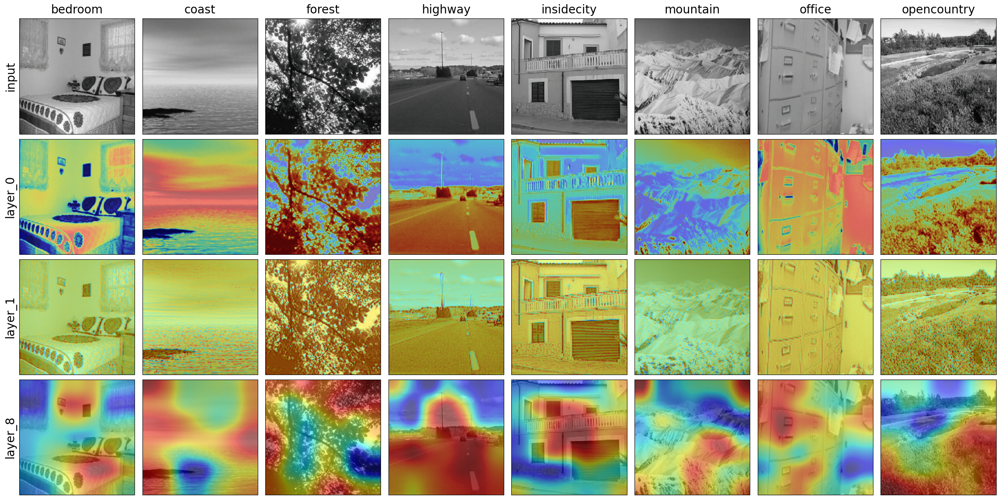

100%|██████████| 3/3 [00:22<00:00,  7.40s/it]


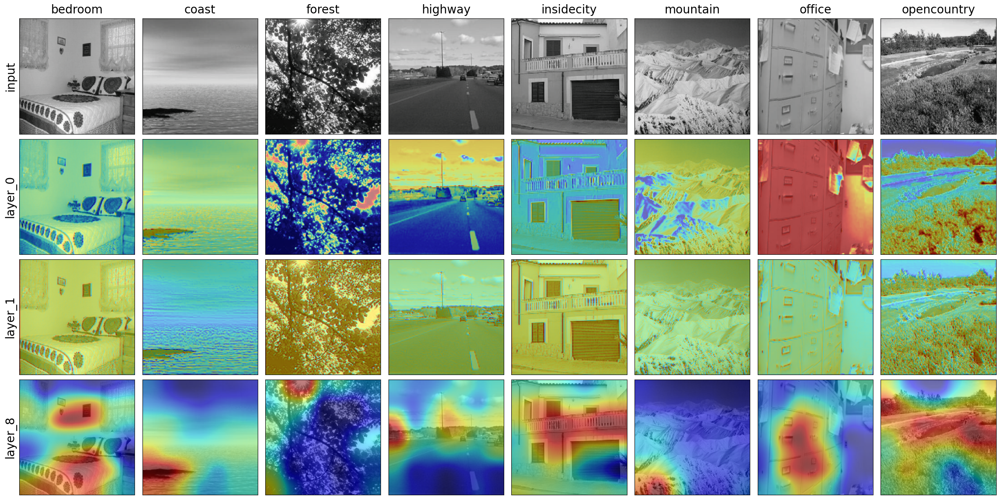

100%|██████████| 3/3 [00:23<00:00,  7.67s/it]


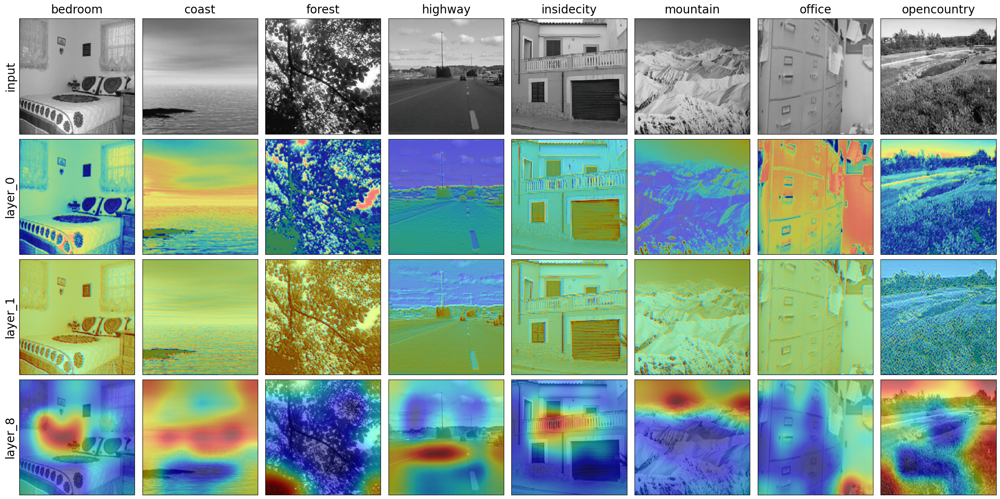

100%|██████████| 3/3 [00:23<00:00,  7.87s/it]


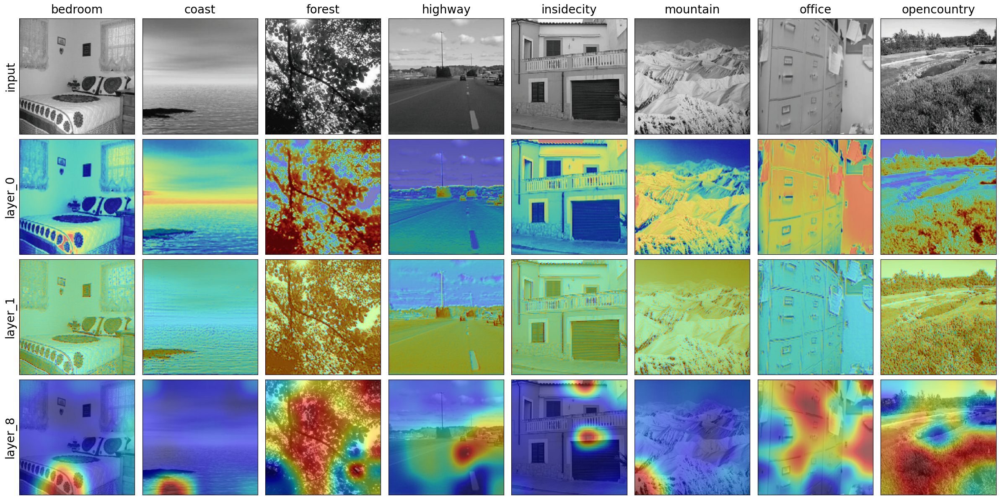

In [13]:
for model_name in MODEL_NAMES:
    model = torch.load(MODELS_PATH + model_name +'.pt', map_location=DEVICE)

    images = []
    layers = [0, 1, 8]
    for img_num in img_nums:
        input_img = inv_normalize(val_dataset[img_num][0])
        input_img = transforms.ToPILImage()(input_img)
        images.append(input_img)

    for layer in tqdm(layers):
        for img_num in img_nums:
            # input_img = inv_normalize(val_dataset[img_num][0])
            # input_img = transforms.ToPILImage()(input_img)
            # images.append(input_img)
            score_cam_result = apply_score_cam(
                val_dataset[img_num][0], 
                model, 
                model.features[layer], 
                inv_normalize, 
                batch_size=64, 
                alpha=0.5
                )
            images.append(score_cam_result)

    layers = ['input'] + ['layer_' + str(i) for i in layers]

    idx_to_class = {v: k for k, v in val_dataset.class_to_idx.items()}
    row_labels = [idx_to_class[val_dataset[img_num][1]] for img_num in img_nums]

    cam_grid_plot = plot_image_grid(images, layers, row_labels)

    cam_grid_plot.savefig(PLOTS_PATH + 'score_cam/v2/' + model_name + '_cam_grid_plot.png', bbox_inches='tight', dpi=300)
